# Options for finding neighbors
> What's the best way to find neighbors from the distance matrix?

- toc: true 
- badges: true
- comments: true

Yesterday, we found that some samples are still far from others after KNN correction.
Why do we see this pattern?
In this notebook, I have explored different options of calculating neighbors.

> Important: I modified the KNN function. Earlier, the distance matrix was always positive and sorting the samples by distance had the self index at the beginning (distance = 0).

## Setup

This notebook requires:   
  1. LD filtered genotype
  2. Gene expression matrix

Data location

In [1]:
#collapse-hide
dosagefile = '/cbscratch/sbanerj/gtex_pca/gtex_v8_filtered.dosage.raw'
dosage_numpy_file = '/cbscratch/sbanerj/gtex_pca/gtex_dosage.npy'
expression_file = '/scratch/sbanerj/trans-eqtl/input/gtex_v8/expression/gtex_ms_raw_std_protein_coding_lncRNA.txt'

Python libraries

In [2]:
#collapse-hide
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
from scipy import stats
import os
from scipy.cluster import hierarchy as hc

import matplotlib.pyplot as plt
import matplotlib
from mpl_toolkits.axes_grid1 import make_axes_locatable
from utils import mpl_stylesheet
mpl_stylesheet.banskt_presentation(fontfamily = 'latex-clearsans', fontsize = 18, colors = 'banskt', dpi = 300)

Read input data

In [3]:
#collapse-hide
def read_gtex(filename): # returns N x G gene expression
    expr_list = list()
    donor_list = list()
    gene_list = list()
    with open(filename) as mfile:
        donor_list = mfile.readline().strip().split("\t")[1:]
        for line in mfile:
            linesplit = line.strip().split("\t")
            gene = linesplit[0].strip()
            gene_list.append(gene)
            expr = np.array([float(x) for x in linesplit[1:]])
            expr_list.append(expr)
    expr = np.transpose(np.array(expr_list))
    return expr, donor_list, gene_list

def center_expression(Y): 
    '''
    Y is N x G
    here we center the columns, the mean of the columns (genes) are subtracted
    '''
    Ycent = Y - np.mean(Y, axis = 0)
    return Ycent

def center_genotype(X):
    '''
    X is N x I
    here we center the columns, the mean of the columns (SNPs) are subtracted
    '''
    return X - np.mean(X, axis = 0).reshape(1, -1)
    

if not os.path.isfile(dosage_numpy_file):
    dosage = np.loadtxt(dosagefile, delimiter=' ', skiprows=1, usecols=range(6, 97612))
    np.save(dosage_numpy_file, dosage)
else:
    dosage = np.load(dosage_numpy_file)
gtsamples = list()
with open (dosagefile, 'r') as infile:
    next(infile)
    for line in infile:
        gtsamples.append(line.strip().split()[1])

gx, gxsamples, _ = read_gtex(expression_file)
gx = center_expression(gx)
sampleidx = [gtsamples.index(x) for x in gxsamples] # assumes all expression samples have genotype
dreduce = dosage[sampleidx, :]
gt = center_genotype(dreduce) #dreduce - np.mean(dreduce, axis = 0).reshape(1, -1)

print(f'{len(sampleidx)} samples, {gx.shape[1]} genes, {gt.shape[1]} SNPs.')
print(f'Centered and normalized genotype and expression. Samples in same order as `gxsamples`')

706 samples, 13236 genes, 97606 SNPs.
Centered and normalized genotype and expression. Samples in same order as `gxsamples`


### Core function modules

1. Calculate PCA, distance matrix and KNN. 
2. Map distance matrix from one sample space to another.  
3. Remove first N principal components from any matrix X.
4. Plotting function.

In [4]:
#collapse-hide
def get_pca(x, K):
    pca = PCA(n_components=K)
    pca.fit(x) # requires N x P (n_samples, n_features)
    x_pca = pca.transform(x)
    return x_pca

def get_distance(a, b):
    return np.linalg.norm(a - b)

def distance_matrix(x_pca):
    nsample = x_pca.shape[0]
    distance_matrix = np.zeros((nsample, nsample))
    for i in range(nsample):
        for j in range(i+1, nsample):
            dist = get_distance(x_pca[i,:], x_pca[j,:])
            distance_matrix[i, j] = dist
            distance_matrix[j, i] = dist
    return distance_matrix

def map_distance_matrix(dm, samples, target_samples):
    N = len(target_samples)
    newdm = np.zeros((N, N))
    newdm[:] = np.nan
    for i in range(N):
        if target_samples[i] in samples:
            newdm[i, i] = 0 # diagonal is always zero
            iold = samples.index(target_samples[i])
            for j in range(i+1, N):
                if target_samples[j] in samples:
                    jold = samples.index(target_samples[j])
                    newdm[i, j] = dm[iold, jold]
                    newdm[j, i] = dm[jold, iold]
    return newdm

def knn(gx, gt, dm, K, center = True):
    assert (gx.shape[0] == gt.shape[0])
    N = gx.shape[0]
    gx_knn = np.zeros_like(gx)
    gt_knn = np.zeros_like(gt)

    for i in range(N):
        #neighbors = np.argsort(distance_matrix[i, :kneighbor + 1])
        ordered_nbrs = np.argsort(dm[i, :])
        self_idx = np.where(ordered_nbrs == i)[0][0]
        neighbors = np.delete(ordered_nbrs, self_idx)[:K]
        gx_knn[i, :] = gx[i, :] - np.mean(gx[neighbors, :], axis = 0)
        gt_knn[:, i] = gt[:, i] - np.mean(gt[:, neighbors], axis = 1)
        
    if center:
        gx_knn -= np.mean(gx_knn, axis = 0)
        gt_knn -= np.mean(gt_knn, axis = 0)
        
    return gx_knn, gt_knn

def remove_nfirst_pcs(X, n=1):    
    Xnorm = X
    U, S, Vt = np.linalg.svd(X, full_matrices=False)
    Xhat = U[:, n:] @ np.diag(S[n:]) @ Vt[n:, :]
    return Xhat

def center_scale_off_diagonal(X):
    ioff = np.where(~np.eye(X.shape[0], dtype=bool))
    X[ioff] = (X[ioff] - np.mean(X[ioff])) / np.std(X[ioff])
    return X

def plot_distance_matrices(dmA, dmB, norms = None):
    '''
    provide norms, if required, as norms = (norm1, norm2)
    where,
    norm1 = matplotlib.colors.DivergingNorm(vmin=10., vcenter=90., vmax=170.)
    norm2 = matplotlib.colors.DivergingNorm(vmin=0., vcenter=90., vmax=300.)
    '''
    
    fig = plt.figure(figsize = (12, 6))
    ax1 = fig.add_subplot(121)
    ax2 = fig.add_subplot(122)
    
    # the zero distance between the same samples
    # is bad for the color scale.
    dmA[np.diag_indices(dmA.shape[0])] = np.nan
    dmB[np.diag_indices(dmB.shape[0])] = np.nan

    cmap1 = plt.get_cmap("YlOrRd")
    cmap1.set_bad('w')

    cmap2 = plt.get_cmap("YlGnBu")
    cmap2.set_bad('w')

    if norms is not None:
        norm1 = norms[0]
        norm2 = norms[1]
        im1 = ax1.imshow(dmA, cmap = cmap1, norm = norm1, interpolation='nearest')
        im2 = ax2.imshow(dmB, cmap = cmap2, norm = norm2, interpolation='nearest')
    else:
        im1 = ax1.imshow(dmA, cmap = cmap1, interpolation='nearest')
        im2 = ax2.imshow(dmB, cmap = cmap2, interpolation='nearest')        


    divider = make_axes_locatable(ax1)
    cax = divider.append_axes("right", size="5%", pad=0.2)
    cbar = plt.colorbar(im1, cax=cax, fraction = 0.1)

    divider = make_axes_locatable(ax2)
    cax = divider.append_axes("right", size="5%", pad=0.2)
    cbar = plt.colorbar(im2, cax=cax, fraction = 0.1)

    ax1.set_title("Genotype space", pad = 20)
    ax2.set_title("Expression space", pad = 20)
    
    plt.tight_layout()
    return fig

## 1. Find neighbors after removing first PC from distance matrix

Johannes suggested that removing the first PC might give better neighbors.

In [5]:
#collapse-show
# Before KNN
DT = 20 # reduced dimension of genotype
DX = 30 # reduced dimension of expression
dm_gt = distance_matrix(get_pca(gt, DT))
dm_gx = distance_matrix(get_pca(gx, DX))
dm_gx_corr = remove_nfirst_pcs(dm_gx, n=1)

# Single-KNN
K = 30
gx_knn, gt_knn = knn(gx, gt, dm_gx_corr, K)
dm_gt_knn = distance_matrix(get_pca(gt_knn, DT))
dm_gx_knn = distance_matrix(get_pca(gx_knn, DX))

I ordered the samples by their distance in the expression space

In [6]:
#collapse-hide
o2 = hc.leaves_list(hc.linkage(dm_gx_corr, method = 'centroid'))

Plot the distance matrices

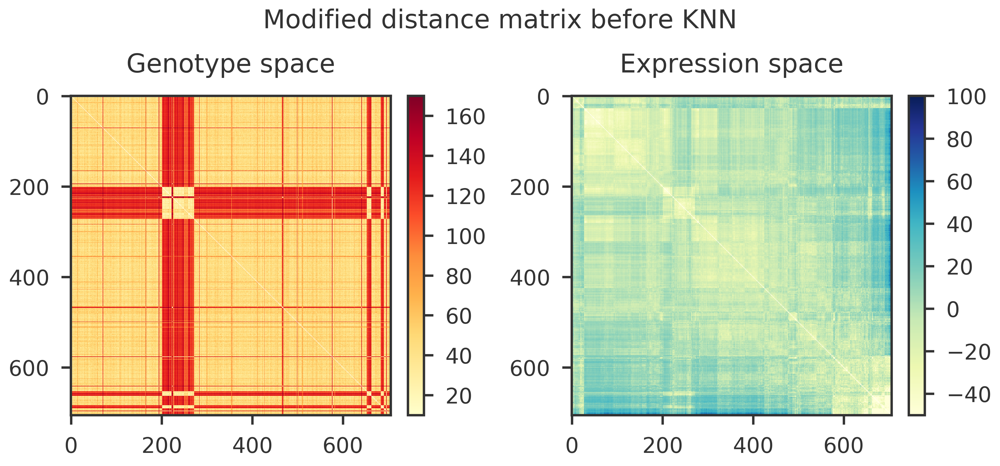

In [7]:
#collapse-hide
mgt = dm_gt[o2, :][:, o2]
mgx = dm_gx_corr[o2, :][:, o2]

norm1 = matplotlib.colors.DivergingNorm(vmin=10., vcenter=90., vmax=170.)
norm2 = matplotlib.colors.DivergingNorm(vmin=-50, vcenter=40, vmax=100.)
norms = (norm1, norm2)
fig = plot_distance_matrices(mgt, mgx, norms = norms)
fig.suptitle("Modified distance matrix before KNN")
plt.show()

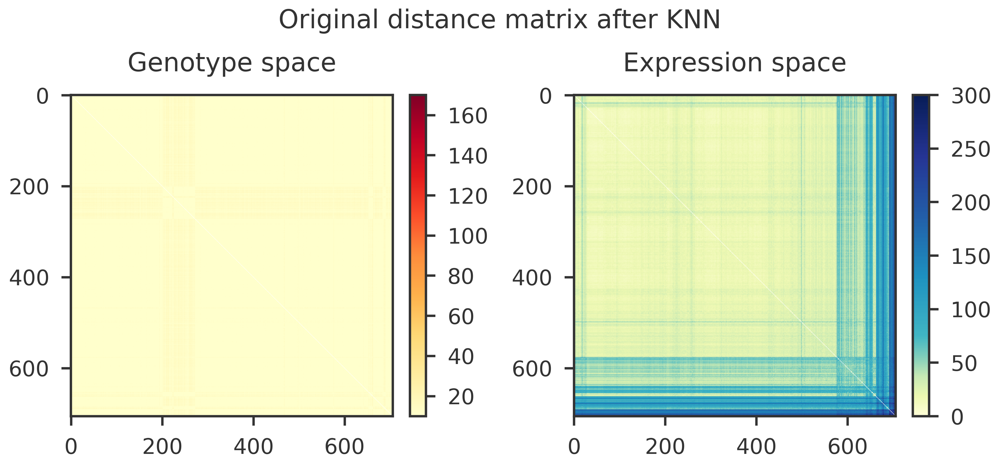

In [8]:
#collapse-hide
mgt = dm_gt_knn[o2, :][:, o2]
mgx = dm_gx_knn[o2, :][:, o2]

norm1 = matplotlib.colors.DivergingNorm(vmin=10., vcenter=90., vmax=170.)
norm2 = matplotlib.colors.DivergingNorm(vmin=0., vcenter=75., vmax=300.)
norms = (norm1, norm2)
fig = plot_distance_matrices(mgt, mgx, norms = norms)
fig.suptitle("Original distance matrix after KNN")
plt.show()

## 2. Find neighbors after removing first PC from log(distance matrix)

Second suggestion of Johannes to get better neighbors

In [9]:
#collapse-show
# Before KNN
DT = 20 # reduced dimension of genotype
DX = 30 # reduced dimension of expression
dm_gt = distance_matrix(get_pca(gt, DT))
dm_gx = distance_matrix(get_pca(gx, DX))
dm_gx_log = np.log(dm_gx + 1.)
dm_gx_log_corr = remove_nfirst_pcs(dm_gx_log, n=1)
dm_gx_corr = np.exp(dm_gx_log_corr) - 1.

# Single-KNN
K = 30
gx_knn, gt_knn = knn(gx, gt, dm_gx_corr, K)
dm_gt_knn = distance_matrix(get_pca(gt_knn, DT))
dm_gx_knn = distance_matrix(get_pca(gx_knn, DX))

I ordered the samples by their distance in the expression space

In [10]:
#collapse-hide
o2 = hc.leaves_list(hc.linkage(dm_gx_corr, method = 'centroid'))

Plot the distance matrices

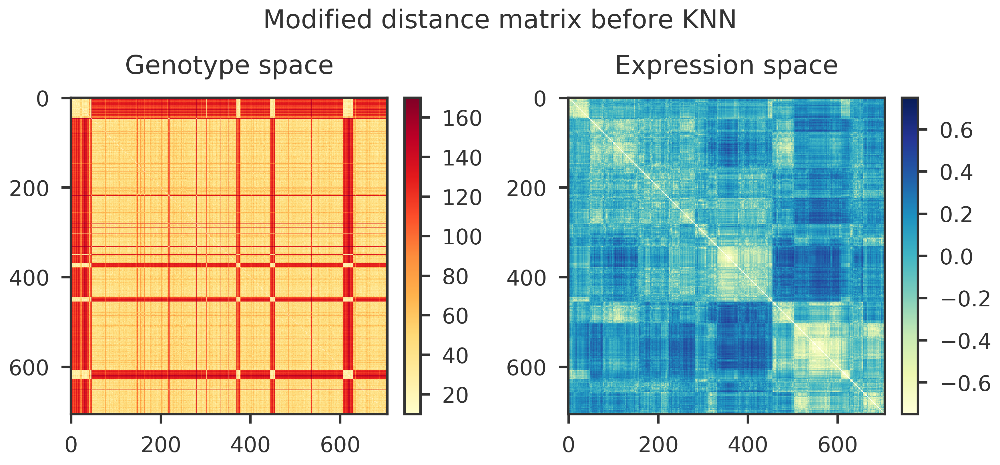

In [11]:
#collapse-hide
mgt = dm_gt[o2, :][:, o2]
mgx = dm_gx_corr[o2, :][:, o2]

norm1 = matplotlib.colors.DivergingNorm(vmin=10., vcenter=90., vmax=170.)
norm2 = matplotlib.colors.DivergingNorm(vmin=-0.75, vcenter=0, vmax=0.75)
norms = (norm1, norm2)
fig = plot_distance_matrices(mgt, mgx, norms = norms)
fig.suptitle("Modified distance matrix before KNN")
plt.show()

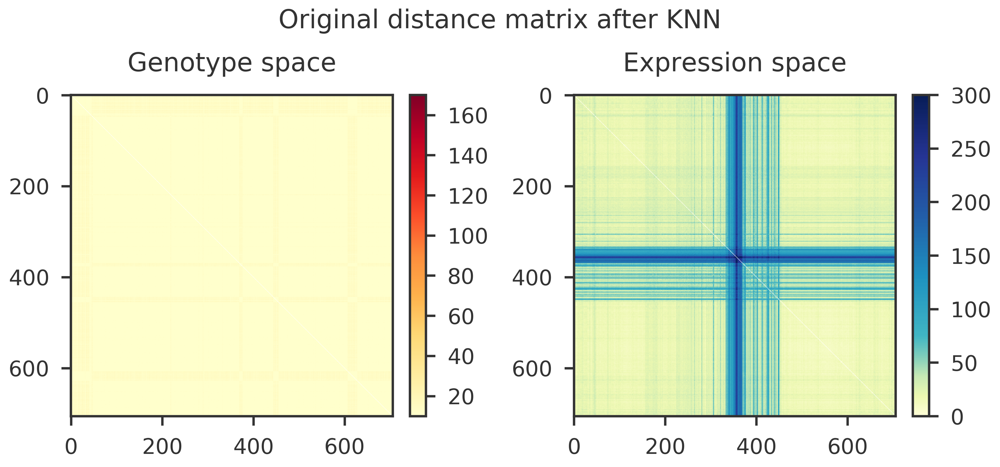

In [12]:
#collapse-hide
mgt = dm_gt_knn[o2, :][:, o2]
mgx = dm_gx_knn[o2, :][:, o2]

norm1 = matplotlib.colors.DivergingNorm(vmin=10., vcenter=90., vmax=170.)
norm2 = matplotlib.colors.DivergingNorm(vmin=0., vcenter=75., vmax=300.)
norms = (norm1, norm2)
fig = plot_distance_matrices(mgt, mgx, norms = norms)
fig.suptitle("Original distance matrix after KNN")
plt.show()

## 3. Calculate neigbors afer centering / scaling distance matrix

The distance matrix is not centered and scaled. Since the matrix is not centered, the [first PC captures the intercept](https://stats.stackexchange.com/questions/22329)
. Therefore, I thought centering / scaling the matrix would give same results as removing the first PC
and maybe, even better.

While centering and scaling, the diagonal elements were left at 0.

In [13]:
#collapse-show

# Before KNN
DT = 20 # reduced dimension of genotype
DX = 30 # reduced dimension of expression
dm_gt = distance_matrix(get_pca(gt, DT))
dm_gx = distance_matrix(get_pca(gx, DX))
dm_gx_corr = center_scale_off_diagonal(dm_gx)

# Single-KNN
K = 30
gx_knn, gt_knn = knn(gx, gt, dm_gx_corr, K)
dm_gt_knn = distance_matrix(get_pca(gt_knn, DT))
dm_gx_knn = distance_matrix(get_pca(gx_knn, DX))

I ordered the samples by their distance in the expression space

In [14]:
#collapse-hide
o2 = hc.leaves_list(hc.linkage(dm_gx_corr, method = 'centroid'))

Plot the distance matrices

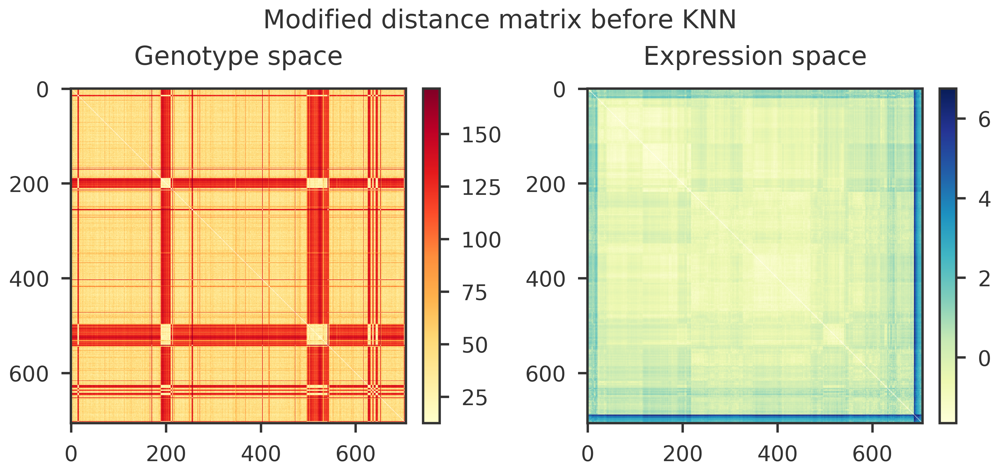

In [15]:
#collapse-hide
mgt = dm_gt[o2, :][:, o2]
mgx = dm_gx_corr[o2, :][:, o2]

norm1 = matplotlib.colors.DivergingNorm(vmin=10., vcenter=90., vmax=170.)
norm2 = matplotlib.colors.DivergingNorm(vmin=-0.75, vcenter=0, vmax=0.75)
norms = (norm1, norm2)
fig = plot_distance_matrices(mgt, mgx)
fig.suptitle("Modified distance matrix before KNN")
plt.show()

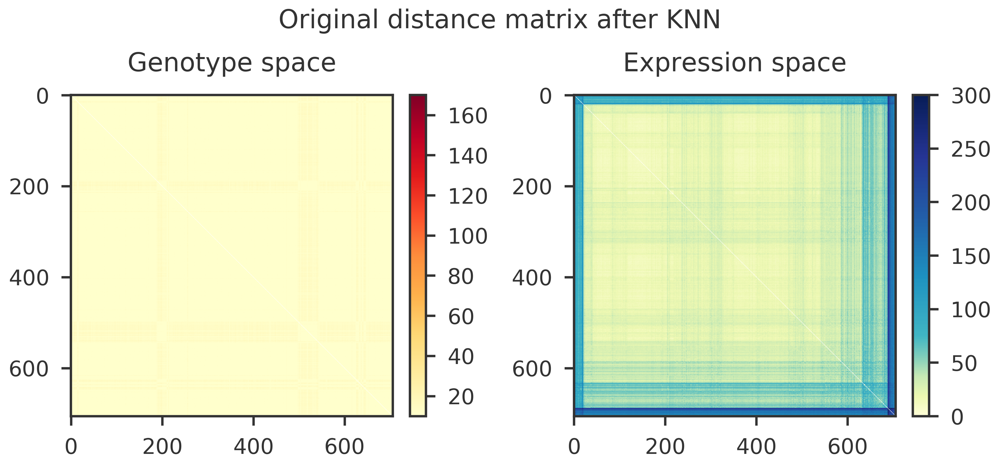

In [16]:
#collapse-hide
mgt = dm_gt_knn[o2, :][:, o2]
mgx = dm_gx_knn[o2, :][:, o2]

norm1 = matplotlib.colors.DivergingNorm(vmin=10., vcenter=90., vmax=170.)
norm2 = matplotlib.colors.DivergingNorm(vmin=0., vcenter=75., vmax=300.)
norms = (norm1, norm2)
fig = plot_distance_matrices(mgt, mgx, norms = norms)
fig.suptitle("Original distance matrix after KNN")
plt.show()

## 4. Apply KNN on quantile normalized gene expression

In attempt 3, I found that some samples are really far apart like outliers. I also found that the samples which are dissimilar to others are because of outlying gene expressions.
Quantile normalization will force all outliers to have the same normal distribution. 
> Warning: This is wrong, quantile normalization removes trans-eQTL information!

Quantile normalize the gene expression matrix

In [17]:
#collapse-hide
def normalize_quantiles(M):
    """
    Note: replicates behavior of R function normalize.quantiles from library("preprocessCore")  
    Reference:
     [1] Bolstad et al., Bioinformatics 19(2), pp. 185-193, 2003
    
    Adapted from https://github.com/andrewdyates/quantile_normalize
    """

    Q = M.argsort(axis=0)
    m,n = M.shape

    # compute quantile vector
    quantiles = np.zeros(m)
    for i in range(n):
        quantiles += M[Q[:,i],i]
    quantiles = quantiles / n

    for i in range(n):
        # Get equivalence classes; unique values == 0
        dupes = np.zeros(m, dtype=np.int)
        for j in range(m-1):
            if M[Q[j,i],i]==M[Q[j+1,i],i]:
                dupes[j+1] = dupes[j]+1

        # Replace column with quantile ranks
        M[Q[:,i],i] = quantiles

        # Average together equivalence classes
        j = m-1
        while j >= 0:
            if dupes[j] == 0:
                j -= 1
            else:
                idxs = Q[j-dupes[j]:j+1,i]
                M[idxs,i] = np.median(M[idxs,i])
                j -= 1 + dupes[j]
        assert j == -1

    return M


def inverse_normal_transform(M):
    """
    Transform rows to a standard normal distribution.
    After quantile normalization of samples, standardize expression of each gene
    """
    R = stats.mstats.rankdata(M, axis=1)  # ties are averaged
    if isinstance(M, pd.DataFrame):
        Q = pd.DataFrame(stats.norm.ppf(R/(M.shape[1]+1)), index=M.index, columns=M.columns)
    else:
        Q = stats.norm.ppf(R/(M.shape[1]+1))
    return Q

gx_qn = inverse_normal_transform(normalize_quantiles(gx))

Calculate KNN and distance matrices.

In [18]:
#collapse-show

# Before KNN
DT = 20 # reduced dimension of genotype
DX = 30 # reduced dimension of expression
dm_gt = distance_matrix(get_pca(gt, DT))
dm_gx = distance_matrix(get_pca(gx_qn, DX))
dm_gx_corr = center_scale_off_diagonal(dm_gx)

# Single-KNN
K = 30
gx_knn, gt_knn = knn(gx_qn, gt, dm_gx_corr, K)
dm_gt_knn = distance_matrix(get_pca(gt_knn, DT))
dm_gx_knn = distance_matrix(get_pca(gx_knn, DX))

I ordered the samples by their distance in the expression space

In [19]:
#collapse-hide
o2 = hc.leaves_list(hc.linkage(dm_gx_corr, method = 'centroid'))

Plot the distance matrices

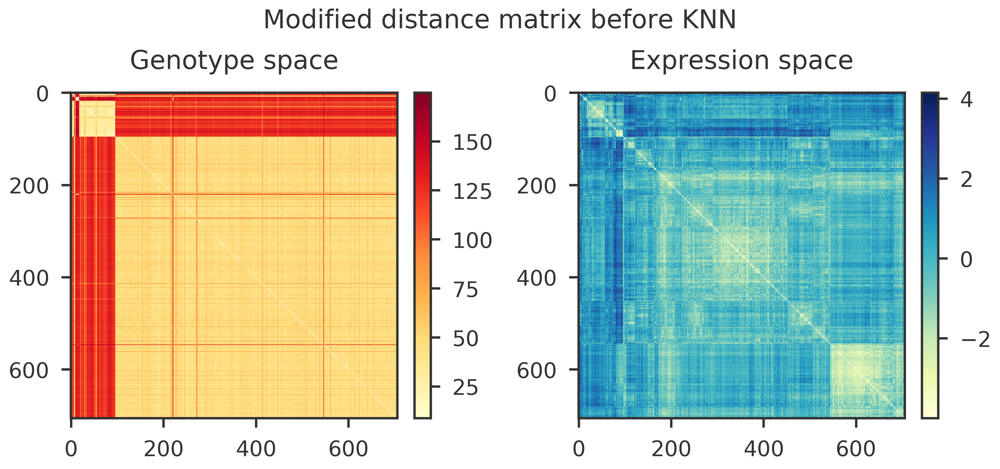

In [20]:
#collapse-hide
mgt = dm_gt[o2, :][:, o2]
mgx = dm_gx_corr[o2, :][:, o2]

norm1 = matplotlib.colors.DivergingNorm(vmin=10., vcenter=90., vmax=170.)
norm2 = matplotlib.colors.DivergingNorm(vmin=-0.75, vcenter=0, vmax=0.75)
norms = (norm1, norm2)
fig = plot_distance_matrices(mgt, mgx)
fig.suptitle("Modified distance matrix before KNN")
plt.show()

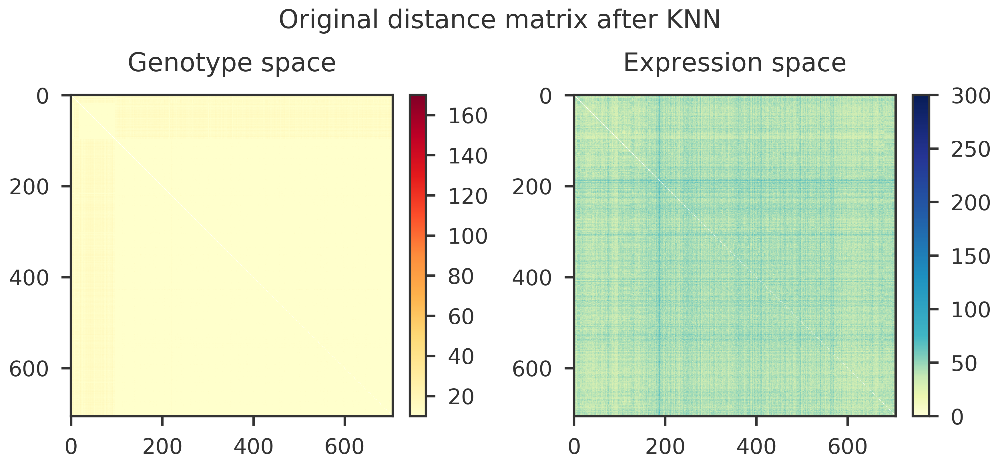

In [21]:
#collapse-hide
mgt = dm_gt_knn[o2, :][:, o2]
mgx = dm_gx_knn[o2, :][:, o2]

norm1 = matplotlib.colors.DivergingNorm(vmin=10., vcenter=90., vmax=170.)
norm2 = matplotlib.colors.DivergingNorm(vmin=0., vcenter=75., vmax=300.)
norms = (norm1, norm2)
fig = plot_distance_matrices(mgt, mgx, norms = norms)
fig.suptitle("Original distance matrix after KNN")
plt.show()

## 5. Calculate neighbors from quantile normalized gene expression and apply on raw data

> Tip: And, this works!

In [22]:
#collapse-show

# Before KNN
DT = 20 # reduced dimension of genotype
DX = 30 # reduced dimension of expression
dm_gt = distance_matrix(get_pca(gt, DT))
dm_gx = distance_matrix(get_pca(gx_qn, DX))
dm_gx_corr = center_scale_off_diagonal(dm_gx)

# Single-KNN
K = 30
gx_knn, gt_knn = knn(gx, gt, dm_gx_corr, K)
dm_gt_knn = distance_matrix(get_pca(gt_knn, DT))
dm_gx_knn = distance_matrix(get_pca(gx_knn, DX))

I ordered the samples by their distance in the expression space

In [23]:
#collapse-hide
o2 = hc.leaves_list(hc.linkage(dm_gx_corr, method = 'centroid'))

Plot the distance matrices

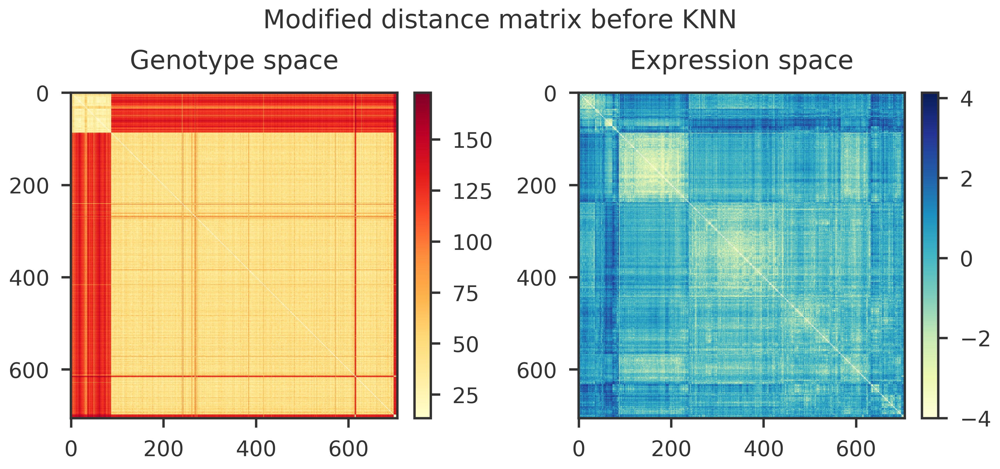

In [24]:
#collapse-hide
mgt = dm_gt[o2, :][:, o2]
mgx = dm_gx_corr[o2, :][:, o2]

norm1 = matplotlib.colors.DivergingNorm(vmin=10., vcenter=90., vmax=170.)
norm2 = matplotlib.colors.DivergingNorm(vmin=-0.75, vcenter=0, vmax=0.75)
norms = (norm1, norm2)
fig = plot_distance_matrices(mgt, mgx)
fig.suptitle("Modified distance matrix before KNN")
plt.show()

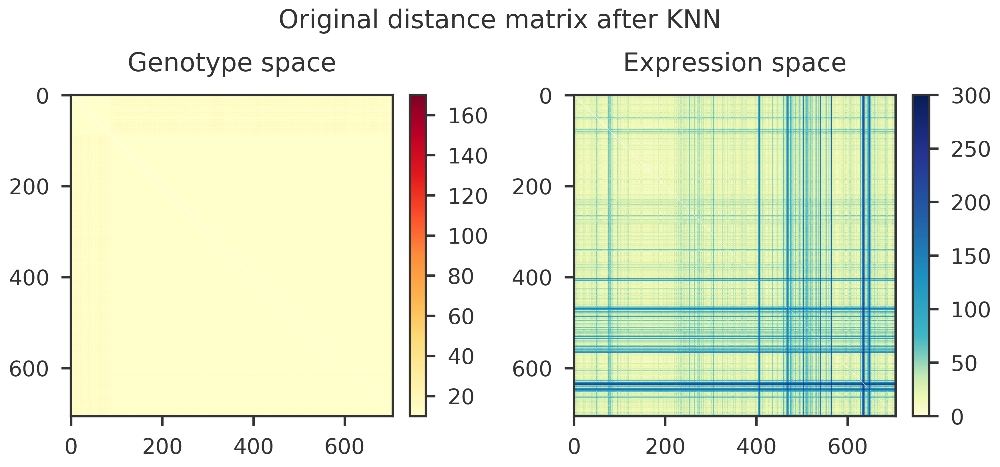

In [25]:
#collapse-hide
mgt = dm_gt_knn[o2, :][:, o2]
mgx = dm_gx_knn[o2, :][:, o2]

norm1 = matplotlib.colors.DivergingNorm(vmin=10., vcenter=90., vmax=170.)
norm2 = matplotlib.colors.DivergingNorm(vmin=0., vcenter=75., vmax=300.)
norms = (norm1, norm2)
fig = plot_distance_matrices(mgt, mgx, norms = norms)
fig.suptitle("Original distance matrix after KNN")
plt.show()